# Single model (`palph2()`) UQ using Dask

Try to capture the input and output uncertainties for a single model in Process. This will be done by sampling the input epistemic uncertainty parameter space to the code as a whole and capturing the input distributions to the model of interest. These input distributions can then be propagated through the model of interest, and the output variance analysed. This allows the uncertainty contribution of an individual model to be assessed, given a set of epistemic uncertainty inputs for the code as a whole.

Dask will be used to parallelise the evaluations. This will be run locally as proof-of-concept.

In [1]:
import easyvvuq as uq
import chaospy as cp
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from dask.distributed import Client
from dask_jobqueue import SLURMCluster


## Campaign to capture input distribution for `palph2()`

Using the epistemic uncertain inputs for the entire code, capture the distribution of inputs for the `palph2()` subroutine.

To start with, make just 2 inputs uncertain (for running locally).

In [2]:
# Create Dask client for local machine
client = Client()
client

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:8787/status,
Dashboard: http://127.0.0.1:8787/status,Workers: 4
Total threads: 8,Total memory: 31.08 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:36825,Workers: 4
Dashboard: http://127.0.0.1:8787/status,Total threads: 8
Started: Just now,Total memory: 31.08 GiB
Comm: tcp://127.0.0.1:38735,Total threads: 2
Dashboard: http://127.0.0.1:36911/status,Memory: 7.77 GiB
Nanny: tcp://127.0.0.1:45161,


Execute the same as before, just with a `client` argument in the actions.

In [3]:
# Define campaign
campaign = uq.Campaign(name="model_inputs", work_dir="campaigns")

# Define parameter space
# Uncertainties from Alex's SA paper

params = {
    "fgwped": {
        "type": "float",
        "min": 1.1,
        "max": 1.3,
        "default": 1.1,
    },  # check: not sure if this is right var
    "hfact": {"type": "float", "min": 1.0, "max": 1.2, "default": 1.1},
    "coreradius": {"type": "float", "min": 0.45, "max": 0.75, "default": 0.75},
    "fimp_2": {"type": "float", "min": 0.085, "max": 0.115, "default": 0.1},  # check
    "fimp_14": {
        "type": "float",
        "min": 1.0e-5,
        "max": 1.0e-4,
        "default": 5e-5,
    },  # check
    "psepbqarmax": {"type": "float", "min": 8.7, "max": 9.7, "default": 9.2},
    "flhthresh": {"type": "float", "min": 0.85, "max": 1.15, "default": 1.15},  # check
    "bscfmax": {"type": "float", "min": 0.95, "max": 1.05, "default": 0.99},
    "peakfactrad": {"type": "float", "min": 2.0, "max": 3.5, "default": 3.33},
    "kappa": {"type": "float", "min": 1.8, "max": 1.9, "default": 1.8},  # check default
    "etaech": {"type": "float", "min": 0.3, "max": 0.5, "default": 0.4},
    "feffcd": {"type": "float", "min": 0.5, "max": 5.0, "default": 1.0},
    "etath": {"type": "float", "min": 0.36, "max": 0.4, "default": 0.375},
    "etaiso": {"type": "float", "min": 0.75, "max": 0.95, "default": 0.9},
    "boundl_18": {
        "type": "float",
        "min": 3.25,
        "max": 3.75,
        "default": 3.5,
    },  # q^95_min
    "pinjalw": {"type": "float", "min": 51.0, "max": 61.0, "default": 51.0},
    "alstroh": {"type": "float", "min": 6.0e8, "max": 7.2e8, "default": 6.6e8},
    "sig_tf_wp_max": {
        "type": "float",
        "min": 5.2e8,
        "max": 6.4e8,
        "default": 5.8e8,
    },  # winding pack, or casing?
    "aspect": {"type": "float", "min": 3.0, "max": 3.2, "default": 3.1},
    "boundu_2": {
        "type": "float",
        "min": 11.0,
        "max": 12.0,
        "default": 11.5,
    },  # B_T^max: check default
    "triang": {"type": "float", "min": 0.4, "max": 0.6, "default": 0.5},
    "out_file": {"type": "string", "default": "out.csv"},
}

# QoIs for palph2(): inputs (args)
palph2_inputs = [
    "bt",
    "bp",
    "dene",
    "deni",
    "dnitot",
    "falpe",
    "falpi",
    "palpnb",
    "ifalphap",
    "pchargepv",
    "pneutpv",
    "ten",
    "tin",
    "vol",
    "palppv",
]

# Create encoder and decoder
encoder = uq.encoders.GenericEncoder(
    template_fname="baseline_2018.template", target_filename="IN.DAT"
)
decoder = uq.decoders.JSONDecoder(
    target_filename="before.json", output_columns=palph2_inputs
)

# Can't use > /dev/null or stdout=subprocess.DEVNULL
cmd = "process -i IN.DAT"
actions = uq.actions.local_execute(encoder, cmd, decoder)
# On cluster:
uq.actions.exec

# Add the app
campaign.add_app(name="single_model", params=params, actions=actions)

# Create PCE sampler
vary = {
    "fgwped": cp.Uniform(1.1, 1.3,), # changes n pow, but not vol
    # "hfact": cp.Uniform(1.0, 1.2,) # doesn't change
    # "coreradius": cp.Uniform(0.45, 0.75) # doesn't change anything, strangely
    # "fimp_2": cp.Uniform(0.085, 0.115,) # doesn't change
    # max psep is a constraint
    # l-h thresh
    # "flhthresh": cp.Uniform(0.85, 1.15) # no change, constraint
    # "bscfmax/cboot": cp.Uniform(0.95, 1.05), # not sure which one to use: both cause probs
    # "bscfmax/cboot": cp.Uniform(0.95, 1.05), # not sure which one to use: both cause probs
    # peaking factor: ignore
    # ignore wall plug efficiency
    # "feffcd": cp.Uniform(1.8, 1.9), # no change
    # ignore therm to electic eff
    # ignore collant pump eff
    # q95 is bound
    # "pinjalw": cp.Uniform(51.0, 61.0), # no change
    # hoop, tresca are both constraints
    # b_T is bound


    "kappa": cp.Uniform(1.8, 1.9), # changes both
    "aspect": cp.Uniform(3.0, 3.2), # changes vol and n pow
    "triang": cp.Uniform(0.4, 0.6), # changes vol and n pow
    

}
pce_sampler = uq.sampling.PCESampler(vary=vary, polynomial_order=3)

# Add pce_sampler to campaign
campaign.set_sampler(pce_sampler)

# Draw samples, execute and collate
campaign.execute(pool=client).collate(progress_bar=True)
samples = campaign.get_collation_result()


The IN.DAT file does not contain any obsolete variables.The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.

The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCM

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.70452446e+19), n0 = array(7.65302556e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.70452446e+19), n0 = array(7.65302556e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.70452446e+19), n0 = array(7.65302556e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.70452446e+19), n0 = array(7.65302556e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.70452446e+19), n0 = array(7.65302556e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.70452446e+19), n0 = array(7.65302556e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
 
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning me

process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.


 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.


 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *************************

process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.


 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Ta

process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.


 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.


 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Ta

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.87519353e+19), n0 = array(7.44990925e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.87519353e+19), n0 = array(7.44990925e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.87519353e+19), n0 = array(7.44990925e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.87519353e+19), n0 = array(7.44990925e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.87519353e+19), n0 = array(7.44990925e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.87519353e+19), n0 = array(7.44990925e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:16 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.70643027e+19), n0 = array(7.65075742e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.70643027e+19), n0 = array(7.65075742e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.70643027e+19), n0 = array(7.65075742e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.70643027e+19), n0 = array(7.65075742e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.70643027e+19), n0 = array(7.65075742e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.70643027e+19), n0 = array(7.65075742e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.70643027e+19), n0 = array(7.65075742e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.70643027e+19), n0 = array(7.65075742e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.70643027e+19), n0 = array(7.65075742e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.70643027e+19), n0 = array(7.65075742e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.70643027e+19), n0 = array(7.65075742e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.70643027e+19), n0 = array(7.65075742e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variable

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8399262e+19), n0 = array(7.49188152e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8399262e+19), n0 = array(7.49188152e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8399262e+19), n0 = array(7.49188152e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8399262e+19), n0 = array(7.49188152e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8399262e+19), n0 = array(7.49188152e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8399262e+19), n0 = array(7.49188152e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.83992

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:17 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8399262e+19), n0 = array(7.49188152e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8399262e+19), n0 = array(7.49188152e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8399262e+19), n0 = array(7.49188152e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8399262e+19), n0 = array(7.49188152e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8399262e+19), n0 = array(7.49188152e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8399262e+19), n0 = array(7.49188152e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.83992

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.


 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Ta

process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79767988e+19), n0 = array(7.54215962e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79767988e+19), n0 = array(7.54215962e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79767988e+19), n0 = array(7.54215962e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79767988e+19), n0 = array(7.54215962e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79767988e+19), n0 = array(7.54215962e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79767988e+19), n0 = array(7.54215962e+19)
process.

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Ta

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79767988e+19), n0 = array(7.54215962e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79767988e+19), n0 = array(7.54215962e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79767988e+19), n0 = array(7.54215962e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79767988e+19), n0 = array(7.54215962e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79767988e+19), n0 = array(7.54215962e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79767988e+19), n0 = array(7.54215962e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:18 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79767988e+19), n0 = array(7.54215962e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79767988e+19), n0 = array(7.54215962e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79767988e+19), n0 = array(7.54215962e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79767988e+19), n0 = array(7.54215962e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79767988e+19), n0 = array(7.54215962e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79767988e+19), n0 = array(7.54215962e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.


The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:19 +00:00(hh:mm) UTC
      User

process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.


The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:19 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.10154295e+19), n0 = array(7.18052675e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.10154295e+19), n0 = array(7.18052675e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.10154295e+19), n0 = array(7.18052675e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.10154295e+19), n0 = array(7.18052675e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.10154295e+19), n0 = array(7.18052675e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.10154295e+19), n0 = array(7.18052675e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:20 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.10154295e+19), n0 = array(7.18052675e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.10154295e+19), n0 = array(7.18052675e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.10154295e+19), n0 = array(7.18052675e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.10154295e+19), n0 = array(7.18052675e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.10154295e+19), n0 = array(7.18052675e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.10154295e+19), n0 = array(7.18052675e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.


 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Ta

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.92646127e+19), n0 = array(7.3888946e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.92646127e+19), n0 = array(7.3888946e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.92646127e+19), n0 = array(7.3888946e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.92646127e+19), n0 = array(7.3888946e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.92646127e+19), n0 = array(7.3888946e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.92646127e+19), n0 = array(7.3888946e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.92646

The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89096435e+19), n0 = array(7.43114011e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89096435e+19), n0 = array(7.43114011e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89096435e+19), n0 = array(7.43114011e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89096435e+19), n0 = array(7.43114011e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89096435e+19), n0 = array(7.43114011e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89096435e+19), n0 = array(7.43114011e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:21 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.71151965e+19), n0 = array(7.64470046e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06526197e+19), n0 = array(7.2237054e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.71151965e+19), n0 = array(7.64470046e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06526197e+19), n0 = array(7.2237054e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06526197e+19), n0 = array(7.2237054e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.71151965e+19), n0 = array(7.64470046e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.71

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.71151965e+19), n0 = array(7.64470046e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.71151965e+19), n0 = array(7.64470046e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.71151965e+19), n0 = array(7.64470046e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.71151965e+19), n0 = array(7.64470046e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.71151965e+19), n0 = array(7.64470046e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedes

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.71151965e+19), n0 = array(7.64470046e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.71151965e+19), n0 = array(7.64470046e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.71151965e+19), n0 = array(7.64470046e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.71151965e+19), n0 = array(7.64470046e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.71151965e+19), n0 = array(7.64470046e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.71151965e+19), n0 = array(7.64470046e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.0218014e+19), n0 = array(7.2754286e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.0218014e+19), n0 = array(7.2754286e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.0218014e+19), n0 = array(7.2754286e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.0218014e+19), n0 = array(7.2754286e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.0218014e+19), n0 = array(7.2754286e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.0218014e+19), n0 = array(7.2754286e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.0218014e+19

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.0218014e+19), n0 = array(7.2754286e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.0218014e+19), n0 = array(7.2754286e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.0218014e+19), n0 = array(7.2754286e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.0218014e+19), n0 = array(7.2754286e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.0218014e+19), n0 = array(7.2754286e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.0218014e+19), n0 = array(7.2754286e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.0218014e+19

The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.848443e+19), n0 = array(7.48174552e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.848443e+19), n0 = array(7.48174552e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.848443e+19), n0 = array(7.48174552e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.848443e+19), n0 = array(7.48174552e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.848443e+19), n0 = array(7.48174552e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.848443e+19), n0 = array(7.48174552e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.848443e+19)

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:24 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.848443e+19), n0 = array(7.48174552e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.848443e+19), n0 = array(7.48174552e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.848443e+19), n0 = array(7.48174552e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.848443e+19), n0 = array(7.48174552e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.848443e+19), n0 = array(7.48174552e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.848443e+19), n0 = array(7.48174552e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.848443e+19)

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8184858e+19), n0 = array(7.51739813e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8184858e+19), n0 = array(7.51739813e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8184858e+19), n0 = array(7.51739813e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8184858e+19), n0 = array(7.51739813e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8184858e+19), n0 = array(7.51739813e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8184858e+19), n0 = array(7.51739813e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.81848

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:24 +00:00(hh:mm) UTC
      User

process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.


 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:24 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.


 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning me

process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.72011953e+19), n0 = array(7.63446558e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.72011953e+19), n0 = array(7.63446558e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.72011953e+19), n0 = array(7.63446558e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.72011953e+19), n0 = array(7.63446558e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.72011953e+19), n0 = array(7.63446558e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedes

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:26 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.09784077e+19), n0 = array(7.18493279e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.09784077e+19), n0 = array(7.18493279e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.09784077e+19), n0 = array(7.18493279e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.09784077e+19), n0 = array(7.18493279e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.09784077e+19), n0 = array(7.18493279e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.09784077e+19), n0 = array(7.18493279e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:26 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9911825e+19), n0 = array(7.3118687e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9911825e+19), n0 = array(7.3118687e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9911825e+19), n0 = array(7.3118687e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9911825e+19), n0 = array(7.3118687e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9911825e+19), n0 = array(7.3118687e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9911825e+19), n0 = array(7.3118687e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9911825e+19

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9911825e+19), n0 = array(7.3118687e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9911825e+19), n0 = array(7.3118687e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9911825e+19), n0 = array(7.3118687e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9911825e+19), n0 = array(7.3118687e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9911825e+19), n0 = array(7.3118687e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9911825e+19), n0 = array(7.3118687e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9911825e+19

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:27 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06157636e+19), n0 = array(7.2280917e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06157636e+19), n0 = array(7.2280917e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06157636e+19), n0 = array(7.2280917e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06157636e+19), n0 = array(7.2280917e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06157636e+19), n0 = array(7.2280917e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06157636e+19), n0 = array(7.2280917e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06157

The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.68554667e+19), n0 = array(7.67561136e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.2778438e+19), n0 = array(6.97070797e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.84158261e+19), n0 = array(7.4899102e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.68554667e+19), n0 = array(7.67561136e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.2778438e+19), n0 = array(6.97070797e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.84158261e+19), n0 = array(7.4899102e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.685

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.68554667e+19), n0 = array(7.67561136e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.68554667e+19), n0 = array(7.67561136e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.68554667e+19), n0 = array(7.67561136e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.68554667e+19), n0 = array(7.67561136e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.68554667e+19), n0 = array(7.67561136e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.68554667e+19), n0 = array(7.67561136e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79932736e+19), n0 = array(7.54019893e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.01813566e+19), n0 = array(7.27979127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79932736e+19), n0 = array(7.54019893e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.01813566e+19), n0 = array(7.27979127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79932736e+19), n0 = array(7.54019893e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.01813566e+19), n0 = array(7.27979127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 triang: 0.4 - 0.6; kappa: 1.5 - 2.0;   plascur: 10 - 20 MA, rmajor: 7 - 11 m;
 rminor: 2 - 3.5 m; tesep: 0 - 0.5 keV; normalised_total_beta: 2 - 3
   plascur =    2.0314E+07
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79932736e+19), n0 = array(7.54019893e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79932736e+19), n0 = array(7.54019893e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79932736e+19), n0 = array(7.54019893e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79932736e+19), n0 = array(7.54019893e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79932736e+19), n0 = array(7.54019893e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.79932736e+19), n0 = array(7.54019893e+19)
process.

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.24077329e+19), n0 = array(7.01482624e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.24077329e+19), n0 = array(7.01482624e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.24077329e+19), n0 = array(7.01482624e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.24077329e+19), n0 = array(7.01482624e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.24077329e+19), n0 = array(7.01482624e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.24077329e+19), n0 = array(7.01482624e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:29 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.76955763e+19), n0 = array(7.57562841e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.76955763e+19), n0 = array(7.57562841e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.76955763e+19), n0 = array(7.57562841e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.76955763e+19), n0 = array(7.57562841e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.76955763e+19), n0 = array(7.57562841e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.76955763e+19), n0 = array(7.57562841e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:30 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98753075e+19), n0 = array(7.31621472e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98753075e+19), n0 = array(7.31621472e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98753075e+19), n0 = array(7.31621472e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98753075e+19), n0 = array(7.31621472e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98753075e+19), n0 = array(7.31621472e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98753075e+19), n0 = array(7.31621472e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.24077329e+19), n0 = array(7.01482624e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.24077329e+19), n0 = array(7.01482624e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.24077329e+19), n0 = array(7.01482624e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.24077329e+19), n0 = array(7.01482624e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.24077329e+19), n0 = array(7.01482624e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.24077329e+19), n0 = array(7.01482624e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:30 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98753075e+19), n0 = array(7.31621472e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98753075e+19), n0 = array(7.31621472e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98753075e+19), n0 = array(7.31621472e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98753075e+19), n0 = array(7.31621472e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98753075e+19), n0 = array(7.31621472e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98753075e+19), n0 = array(7.31621472e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:31 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98753075e+19), n0 = array(7.31621472e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98753075e+19), n0 = array(7.31621472e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98753075e+19), n0 = array(7.31621472e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98753075e+19), n0 = array(7.31621472e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98753075e+19), n0 = array(7.31621472e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98753075e+19), n0 = array(7.31621472e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:31 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.19636696e+19), n0 = array(7.067675e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.19636696e+19), n0 = array(7.067675e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.19636696e+19), n0 = array(7.067675e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.19636696e+19), n0 = array(7.067675e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.19636696e+19), n0 = array(7.067675e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.19636696e+19), n0 = array(7.067675e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.19636696e+1

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 *****************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16508175e+19), n0 = array(7.1049081e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16508175e+19), n0 = array(7.1049081e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16508175e+19), n0 = array(7.1049081e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16508175e+19), n0 = array(7.1049081e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16508175e+19), n0 = array(7.1049081e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16508175e+19), n0 = array(7.1049081e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16508

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89332475e+19), n0 = array(7.44940795e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89332475e+19), n0 = array(7.44940795e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89332475e+19), n0 = array(7.44940795e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89332475e+19), n0 = array(7.44940795e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89332475e+19), n0 = array(7.44940795e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89332475e+19), n0 = array(7.44940795e+19)
process.

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89332475e+19), n0 = array(7.44940795e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89332475e+19), n0 = array(7.44940795e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89332475e+19), n0 = array(7.44940795e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89332475e+19), n0 = array(7.44940795e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89332475e+19), n0 = array(7.44940795e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89332475e+19), n0 = array(7.44940795e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:32 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06499691e+19), n0 = array(7.24555624e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06499691e+19), n0 = array(7.24555624e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06499691e+19), n0 = array(7.24555624e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06499691e+19), n0 = array(7.24555624e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06499691e+19), n0 = array(7.24555624e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06499691e+19), n0 = array(7.24555624e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85797622e+19), n0 = array(7.49138247e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85797622e+19), n0 = array(7.49138247e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85797622e+19), n0 = array(7.49138247e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85797622e+19), n0 = array(7.49138247e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85797622e+19), n0 = array(7.49138247e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85797622e+19), n0 = array(7.49138247e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:34 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.02887959e+19), n0 = array(7.28844367e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.02887959e+19), n0 = array(7.28844367e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.02887959e+19), n0 = array(7.28844367e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.02887959e+19), n0 = array(7.28844367e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.02887959e+19), n0 = array(7.28844367e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.02887959e+19), n0 = array(7.28844367e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:35 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85797622e+19), n0 = array(7.49138247e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85797622e+19), n0 = array(7.49138247e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85797622e+19), n0 = array(7.49138247e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85797622e+19), n0 = array(7.49138247e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85797622e+19), n0 = array(7.49138247e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85797622e+19), n0 = array(7.49138247e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

The IN.DAT file does not contain any obsolete variables.
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.


 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:35 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.81563264e+19), n0 = array(7.54166326e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.81563264e+19), n0 = array(7.54166326e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.81563264e+19), n0 = array(7.54166326e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.81563264e+19), n0 = array(7.54166326e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.81563264e+19), n0 = array(7.54166326e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.81563264e+19), n0 = array(7.54166326e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.


 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.


The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-p

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85011361e+19), n0 = array(7.50071891e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85011361e+19), n0 = array(7.50071891e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85011361e+19), n0 = array(7.50071891e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85011361e+19), n0 = array(7.50071891e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85011361e+19), n0 = array(7.50071891e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85011361e+19), n0 = array(7.50071891e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Ta

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.6962874e+19), n0 = array(7.68337949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.6962874e+19), n0 = array(7.68337949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.6962874e+19), n0 = array(7.68337949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.6962874e+19), n0 = array(7.68337949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.6962874e+19), n0 = array(7.68337949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.6962874e+19), n0 = array(7.68337949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.69628

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85011361e+19), n0 = array(7.50071891e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85011361e+19), n0 = array(7.50071891e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85011361e+19), n0 = array(7.50071891e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85011361e+19), n0 = array(7.50071891e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85011361e+19), n0 = array(7.50071891e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.85011361e+19), n0 = array(7.50071891e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06699189e+19), n0 = array(7.24318731e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06699189e+19), n0 = array(7.24318731e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06699189e+19), n0 = array(7.24318731e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06699189e+19), n0 = array(7.24318731e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06699189e+19), n0 = array(7.24318731e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06699189e+19), n0 = array(7.24318731e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:40 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.78580067e+19), n0 = array(7.57708716e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.78580067e+19), n0 = array(7.57708716e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.78580067e+19), n0 = array(7.57708716e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.78580067e+19), n0 = array(7.57708716e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.78580067e+19), n0 = array(7.57708716e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.78580067e+19), n0 = array(7.57708716e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code **********

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03086564e+19), n0 = array(7.28608534e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03086564e+19), n0 = array(7.28608534e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03086564e+19), n0 = array(7.28608534e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03086564e+19), n0 = array(7.28608534e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03086564e+19), n0 = array(7.28608534e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03086564e+19), n0 = array(7.28608534e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.78580067e+19), n0 = array(7.57708716e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.78580067e+19), n0 = array(7.57708716e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.78580067e+19), n0 = array(7.57708716e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.78580067e+19), n0 = array(7.57708716e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.78580067e+19), n0 = array(7.57708716e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.78580067e+19), n0 = array(7.57708716e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8149586e+19), n0 = array(7.54246365e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8149586e+19), n0 = array(7.54246365e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8149586e+19), n0 = array(7.54246365e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8149586e+19), n0 = array(7.54246365e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8149586e+19), n0 = array(7.54246365e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.8149586e+19), n0 = array(7.54246365e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.81495

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Ta

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98759042e+19), n0 = array(7.3374724e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98759042e+19), n0 = array(7.3374724e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98759042e+19), n0 = array(7.3374724e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98759042e+19), n0 = array(7.3374724e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98759042e+19), n0 = array(7.3374724e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98759042e+19), n0 = array(7.3374724e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98759

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:43 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98759042e+19), n0 = array(7.3374724e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98759042e+19), n0 = array(7.3374724e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.77284682e+19), n0 = array(7.59246918e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.77284682e+19), n0 = array(7.59246918e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98759042e+19), n0 = array(7.3374724e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.77284682e+19), n0 = array(7.59246918e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.77

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:44 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9571021e+19), n0 = array(7.37367569e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9571021e+19), n0 = array(7.37367569e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9571021e+19), n0 = array(7.37367569e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9571021e+19), n0 = array(7.37367569e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9571021e+19), n0 = array(7.37367569e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9571021e+19), n0 = array(7.37367569e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.95710

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:45 +00:00(hh:mm) UTC
      User

ty pedestal is higher than core density. nped = array(7.74317817e+19), n0 = array(7.62769915e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.74317817e+19), n0 = array(7.62769915e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.74317817e+19), n0 = array(7.62769915e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.74317817e+19), n0 = array(7.62769915e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.74317817e+19), n0 = array(7.62769915e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.74317817e+19), n0 = array(7.62769915e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.74317817e+19), n0 = array(7.62769915e+19)
process.

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98759042e+19), n0 = array(7.3374724e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.77284682e+19), n0 = array(7.59246918e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98759042e+19), n0 = array(7.3374724e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.77284682e+19), n0 = array(7.59246918e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98759042e+19), n0 = array(7.3374724e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.77284682e+19), n0 = array(7.59246918e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.98

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:45 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9571021e+19), n0 = array(7.37367569e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20673371e+19), n0 = array(7.07725121e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9571021e+19), n0 = array(7.37367569e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20673371e+19), n0 = array(7.07725121e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20673371e+19), n0 = array(7.07725121e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.9571021e+19), n0 = array(7.37367569e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.77284682e+19), n0 = array(7.59246918e+19)
process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.74317817e+19), n0 = array(7.62769915e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.74317817e+19), n0 = array(7.62769915e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.74317817e+19), n0 = array(7.62769915e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.74317817e+19), n0 = array(7.62769915e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.74317817e+19), n0 = array(7.62769915e+19)
process.

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.74317817e+19), n0 = array(7.62769915e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.74317817e+19), n0 = array(7.62769915e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.74317817e+19), n0 = array(7.62769915e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.74317817e+19), n0 = array(7.62769915e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.74317817e+19), n0 = array(7.62769915e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.74317817e+19), n0 = array(7.62769915e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20673371e+19), n0 = array(7.07725121e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20673371e+19), n0 = array(7.07725121e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20673371e+19), n0 = array(7.07725121e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20673371e+19), n0 = array(7.07725121e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20673371e+19), n0 = array(7.07725121e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20673371e+19), n0 = array(7.07725121e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:47 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20673371e+19), n0 = array(7.07725121e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20673371e+19), n0 = array(7.07725121e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20673371e+19), n0 = array(7.07725121e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20673371e+19), n0 = array(7.07725121e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20673371e+19), n0 = array(7.07725121e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20673371e+19), n0 = array(7.07725121e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:47 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.2973175e+19), n0 = array(6.96968771e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16251081e+19), n0 = array(7.1297636e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20673371e+19), n0 = array(7.07725121e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16251081e+19), n0 = array(7.1297636e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.2973175e+19), n0 = array(6.96968771e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20673371e+19), n0 = array(7.07725121e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.162

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13135482e+19), n0 = array(7.1667597e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13135482e+19), n0 = array(7.1667597e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13135482e+19), n0 = array(7.1667597e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13135482e+19), n0 = array(7.1667597e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13135482e+19), n0 = array(7.1667597e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13135482e+19), n0 = array(7.1667597e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13135

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:48 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.2973175e+19), n0 = array(6.96968771e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.2973175e+19), n0 = array(6.96968771e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.2973175e+19), n0 = array(6.96968771e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.2973175e+19), n0 = array(6.96968771e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.2973175e+19), n0 = array(6.96968771e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.2973175e+19), n0 = array(6.96968771e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.29731

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13135482e+19), n0 = array(7.1667597e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16251081e+19), n0 = array(7.1297636e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13135482e+19), n0 = array(7.1667597e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16251081e+19), n0 = array(7.1297636e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13135482e+19), n0 = array(7.1667597e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16251081e+19), n0 = array(7.1297636e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13135

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16251081e+19), n0 = array(7.1297636e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16251081e+19), n0 = array(7.1297636e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16251081e+19), n0 = array(7.1297636e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16251081e+19), n0 = array(7.1297636e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16251081e+19), n0 = array(7.1297636e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16251081e+19), n0 = array(7.1297636e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16251

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.87729854e+19), n0 = array(7.46843823e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.87729854e+19), n0 = array(7.46843823e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.87729854e+19), n0 = array(7.46843823e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.87729854e+19), n0 = array(7.46843823e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.87729854e+19), n0 = array(7.46843823e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.87729854e+19), n0 = array(7.46843823e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:49 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.26015979e+19), n0 = array(7.01381055e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.26015979e+19), n0 = array(7.01381055e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.26015979e+19), n0 = array(7.01381055e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.26015979e+19), n0 = array(7.01381055e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.26015979e+19), n0 = array(7.01381055e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.26015979e+19), n0 = array(7.01381055e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:49 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.91273398e+19), n0 = array(7.4263605e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.91273398e+19), n0 = array(7.4263605e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.91273398e+19), n0 = array(7.4263605e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.91273398e+19), n0 = array(7.4263605e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.91273398e+19), n0 = array(7.4263605e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.91273398e+19), n0 = array(7.4263605e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.91273

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.48059075e+19), n0 = array(6.75206032e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.48059075e+19), n0 = array(6.75206032e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.48059075e+19), n0 = array(6.75206032e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.48059075e+19), n0 = array(6.75206032e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.48059075e+19), n0 = array(6.75206032e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.48059075e+19), n0 = array(6.75206032e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:50 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03616928e+19), n0 = array(7.27978755e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03616928e+19), n0 = array(7.27978755e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03616928e+19), n0 = array(7.27978755e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03616928e+19), n0 = array(7.27978755e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03616928e+19), n0 = array(7.27978755e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03616928e+19), n0 = array(7.27978755e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:51 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.91273398e+19), n0 = array(7.4263605e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.91273398e+19), n0 = array(7.4263605e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.91273398e+19), n0 = array(7.4263605e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.91273398e+19), n0 = array(7.4263605e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.91273398e+19), n0 = array(7.4263605e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.91273398e+19), n0 = array(7.4263605e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.91273

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.48059075e+19), n0 = array(6.75206032e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.44261229e+19), n0 = array(6.79715775e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.26015979e+19), n0 = array(7.01381055e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.48059075e+19), n0 = array(6.75206032e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.44261229e+19), n0 = array(6.79715775e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.26015979e+19), n0 = array(7.01381055e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.99286548e+19), n0 = array(7.33120854e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.99286548e+19), n0 = array(7.33120854e+19)


 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:51 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.99286548e+19), n0 = array(7.33120854e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.99286548e+19), n0 = array(7.33120854e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.99286548e+19), n0 = array(7.33120854e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.99286548e+19), n0 = array(7.33120854e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.99286548e+19), n0 = array(7.33120854e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.99286548e+19), n0 = array(7.33120854e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.39711833e+19), n0 = array(6.85117945e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.39711833e+19), n0 = array(6.85117945e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.39711833e+19), n0 = array(6.85117945e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.39711833e+19), n0 = array(6.85117945e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.39711833e+19), n0 = array(6.85117945e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.39711833e+19), n0 = array(6.85117945e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:53 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.83485084e+19), n0 = array(7.51884266e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.83485084e+19), n0 = array(7.51884266e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.99286548e+19), n0 = array(7.33120854e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.83485084e+19), n0 = array(7.51884266e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.99286548e+19), n0 = array(7.33120854e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.83485084e+19), n0 = array(7.51884266e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.


The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:53 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.96235702e+19), n0 = array(7.36743574e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.96235702e+19), n0 = array(7.36743574e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.96235702e+19), n0 = array(7.36743574e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.96235702e+19), n0 = array(7.36743574e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.96235702e+19), n0 = array(7.36743574e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.96235702e+19), n0 = array(7.36743574e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.83485084e+19), n0 = array(7.51884266e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.83485084e+19), n0 = array(7.51884266e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.83485084e+19), n0 = array(7.51884266e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.83485084e+19), n0 = array(7.51884266e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.83485084e+19), n0 = array(7.51884266e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.96235702e+19), n0 = array(7.36743574e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:55 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36506685e+19), n0 = array(6.8892389e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36506685e+19), n0 = array(6.8892389e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36506685e+19), n0 = array(6.8892389e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36506685e+19), n0 = array(6.8892389e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36506685e+19), n0 = array(6.8892389e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36506685e+19), n0 = array(6.8892389e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36506

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.96235702e+19), n0 = array(7.36743574e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.96235702e+19), n0 = array(7.36743574e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.96235702e+19), n0 = array(7.36743574e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.96235702e+19), n0 = array(7.36743574e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.96235702e+19), n0 = array(7.36743574e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.96235702e+19), n0 = array(7.36743574e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:55 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47671535e+19), n0 = array(6.75666215e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47671535e+19), n0 = array(6.75666215e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47671535e+19), n0 = array(6.75666215e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47671535e+19), n0 = array(6.75666215e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47671535e+19), n0 = array(6.75666215e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47671535e+19), n0 = array(6.75666215e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47671535e+19), n0 = array(6.75666215e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47671535e+19), n0 = array(6.75666215e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47671535e+19), n0 = array(6.75666215e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47671535e+19), n0 = array(6.75666215e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47671535e+19), n0 = array(6.75666215e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47671535e+19), n0 = array(6.75666215e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 **************

process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.80494552e+19), n0 = array(7.55435366e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.80494552e+19), n0 = array(7.55435366e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.80494552e+19), n0 = array(7.55435366e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.80494552e+19), n0 = array(7.55435366e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.80494552e+19), n0 = array(7.55435366e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.80494552e+19), n0 = array(7.55435366e+19)
process.

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:56 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.80494552e+19), n0 = array(7.55435366e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.80494552e+19), n0 = array(7.55435366e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.80494552e+19), n0 = array(7.55435366e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.80494552e+19), n0 = array(7.55435366e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.80494552e+19), n0 = array(7.55435366e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.80494552e+19), n0 = array(7.55435366e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.18429018e+19), n0 = array(7.10390174e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.18429018e+19), n0 = array(7.10390174e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.18429018e+19), n0 = array(7.10390174e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.18429018e+19), n0 = array(7.10390174e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.18429018e+19), n0 = array(7.10390174e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.18429018e+19), n0 = array(7.10390174e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:58 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.08132163e+19), n0 = array(7.22617149e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.08132163e+19), n0 = array(7.22617149e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.08132163e+19), n0 = array(7.22617149e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.18429018e+19), n0 = array(7.10390174e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.18429018e+19), n0 = array(7.10390174e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.08132163e+19), n0 = array(7.22617149e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:58 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.04513121e+19), n0 = array(7.26914573e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.04513121e+19), n0 = array(7.26914573e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.04513121e+19), n0 = array(7.26914573e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.04513121e+19), n0 = array(7.26914573e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.04513121e+19), n0 = array(7.26914573e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.04513121e+19), n0 = array(7.26914573e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.04513121e+19), n0 = array(7.26914573e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.04513121e+19), n0 = array(7.26914573e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.04513121e+19), n0 = array(7.26914573e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.04513121e+19), n0 = array(7.26914573e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.04513121e+19), n0 = array(7.26914573e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.04513121e+19), n0 = array(7.26914573e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:59 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.04513121e+19), n0 = array(7.26914573e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.04513121e+19), n0 = array(7.26914573e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.04513121e+19), n0 = array(7.26914573e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.04513121e+19), n0 = array(7.26914573e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.04513121e+19), n0 = array(7.26914573e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.04513121e+19), n0 = array(7.26914573e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:31:59 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.62633528e+19), n0 = array(6.57899632e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.62633528e+19), n0 = array(6.57899632e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.62633528e+19), n0 = array(6.57899632e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.62633528e+19), n0 = array(6.57899632e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.62633528e+19), n0 = array(6.57899632e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.62633528e+19), n0 = array(6.57899632e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:00 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16423537e+19), n0 = array(7.12771577e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16423537e+19), n0 = array(7.12771577e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16423537e+19), n0 = array(7.12771577e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16423537e+19), n0 = array(7.12771577e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16423537e+19), n0 = array(7.12771577e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16423537e+19), n0 = array(7.12771577e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16423537e+19), n0 = array(7.12771577e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16423537e+19), n0 = array(7.12771577e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16423537e+19), n0 = array(7.12771577e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16423537e+19), n0 = array(7.12771577e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16423537e+19), n0 = array(7.12771577e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.16423537e+19), n0 = array(7.12771577e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:01 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20846762e+19), n0 = array(7.07519229e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20846762e+19), n0 = array(7.07519229e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20846762e+19), n0 = array(7.07519229e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20846762e+19), n0 = array(7.07519229e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20846762e+19), n0 = array(7.07519229e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20846762e+19), n0 = array(7.07519229e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:02 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.00177912e+19), n0 = array(7.32062406e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.00177912e+19), n0 = array(7.32062406e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.00177912e+19), n0 = array(7.32062406e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.00177912e+19), n0 = array(7.32062406e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.00177912e+19), n0 = array(7.32062406e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.00177912e+19), n0 = array(7.32062406e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.00177912e+19), n0 = array(7.32062406e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.00177912e+19), n0 = array(7.32062406e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.00177912e+19), n0 = array(7.32062406e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.00177912e+19), n0 = array(7.32062406e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.00177912e+19), n0 = array(7.32062406e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.00177912e+19), n0 = array(7.32062406e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:02 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.43875424e+19), n0 = array(6.80173898e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20846762e+19), n0 = array(7.07519229e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20846762e+19), n0 = array(7.07519229e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20846762e+19), n0 = array(7.07519229e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20846762e+19), n0 = array(7.07519229e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.20846762e+19), n0 = array(7.07519229e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54710235e+19), n0 = array(6.67308128e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54710235e+19), n0 = array(6.67308128e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54710235e+19), n0 = array(6.67308128e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54710235e+19), n0 = array(6.67308128e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54710235e+19), n0 = array(6.67308128e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54710235e+19), n0 = array(6.67308128e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54710235e+19), n0 = array(6.67308128e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54710235e+19), n0 = array(6.67308128e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54710235e+19), n0 = array(6.67308128e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54710235e+19), n0 = array(6.67308128e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54710235e+19), n0 = array(6.67308128e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54710235e+19), n0 = array(6.67308128e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:03 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.39328107e+19), n0 = array(6.85573599e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.39328107e+19), n0 = array(6.85573599e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54710235e+19), n0 = array(6.67308128e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.39328107e+19), n0 = array(6.85573599e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54710235e+19), n0 = array(6.67308128e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.39328107e+19), n0 = array(6.85573599e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************

process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.97123664e+19), n0 = array(7.35689166e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.97123664e+19), n0 = array(7.35689166e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.97123664e+19), n0 = array(7.35689166e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.97123664e+19), n0 = array(7.35689166e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.97123664e+19), n0 = array(7.35689166e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedes

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:05 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.57985131e+19), n0 = array(6.63419361e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.57985131e+19), n0 = array(6.63419361e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.57985131e+19), n0 = array(6.63419361e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.57985131e+19), n0 = array(6.63419361e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.57985131e+19), n0 = array(6.63419361e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.57985131e+19), n0 = array(6.63419361e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36124425e+19), n0 = array(6.89377805e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36124425e+19), n0 = array(6.89377805e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36124425e+19), n0 = array(6.89377805e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36124425e+19), n0 = array(6.89377805e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36124425e+19), n0 = array(6.89377805e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36124425e+19), n0 = array(6.89377805e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36124425e+19), n0 = array(6.89377805e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36124425e+19), n0 = array(6.89377805e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36124425e+19), n0 = array(6.89377805e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36124425e+19), n0 = array(6.89377805e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36124425e+19), n0 = array(6.89377805e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.36124425e+19), n0 = array(6.89377805e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:06 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.97123664e+19), n0 = array(7.35689166e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.97123664e+19), n0 = array(7.35689166e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.97123664e+19), n0 = array(7.35689166e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.97123664e+19), n0 = array(7.35689166e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.97123664e+19), n0 = array(7.35689166e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.97123664e+19), n0 = array(7.35689166e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:07 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.35362945e+19), n0 = array(6.92909068e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.35362945e+19), n0 = array(6.92909068e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.35362945e+19), n0 = array(6.92909068e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.35362945e+19), n0 = array(6.92909068e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.35362945e+19), n0 = array(6.92909068e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.35362945e+19), n0 = array(6.92909068e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13058321e+19), n0 = array(7.19324498e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13058321e+19), n0 = array(7.19324498e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13058321e+19), n0 = array(7.19324498e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13058321e+19), n0 = array(7.19324498e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13058321e+19), n0 = array(7.19324498e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13058321e+19), n0 = array(7.19324498e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13058321e+19), n0 = array(7.19324498e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.35362945e+19), n0 = array(6.92909068e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13058321e+19), n0 = array(7.19324498e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.35362945e+19), n0 = array(6.92909068e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.13058321e+19), n0 = array(7.19324498e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.35362945e+19), n0 = array(6.92909068e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.93667965e+19), n0 = array(7.42288551e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.93667965e+19), n0 = array(7.42288551e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.93667965e+19), n0 = array(7.42288551e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.93667965e+19), n0 = array(7.42288551e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.97238222e+19), n0 = array(7.38060287e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.93667965e+19), n0 = array(7.42288551e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5353128e+19), n0 = array(6.71392258e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5353128e+19), n0 = array(6.71392258e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5353128e+19), n0 = array(6.71392258e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5353128e+19), n0 = array(6.71392258e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5353128e+19), n0 = array(6.71392258e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5353128e+19), n0 = array(6.71392258e+19)
process.plasma

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5353128e+19), n0 = array(6.71392258e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5353128e+19), n0 = array(6.71392258e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5353128e+19), n0 = array(6.71392258e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5353128e+19), n0 = array(6.71392258e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5353128e+19), n0 = array(6.71392258e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5353128e+19), n0 = array(6.71392258e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.53531

The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.31621955e+19), n0 = array(6.97339533e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49708927e+19), n0 = array(6.75919081e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.31621955e+19), n0 = array(6.97339533e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49708927e+19), n0 = array(6.75919081e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.31621955e+19), n0 = array(6.97339533e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49708927e+19), n0 = array(6.75919081e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.09417217e+19), n0 = array(7.23636667e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5353128e+19), n0 = array(6.71392258e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.09417217e+19), n0 = array(7.23636667e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5353128e+19), n0 = array(6.71392258e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.09417217e+19), n0 = array(7.23636667e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5353128e+19), n0 = array(6.71392258e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.09

The IN.DAT file does not contain any obsolete variables.
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49708927e+19), n0 = array(6.75919081e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89391196e+19), n0 = array(7.47353541e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49708927e+19), n0 = array(6.75919081e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89391196e+19), n0 = array(7.47353541e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49708927e+19), n0 = array(6.75919081e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.89391196e+19), n0 = array(7.47353541e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:11 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45130176e+19), n0 = array(6.81341709e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45130176e+19), n0 = array(6.81341709e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45130176e+19), n0 = array(6.81341709e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45130176e+19), n0 = array(6.81341709e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45130176e+19), n0 = array(6.81341709e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45130176e+19), n0 = array(6.81341709e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27140667e+19), n0 = array(7.02646735e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27140667e+19), n0 = array(7.02646735e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27140667e+19), n0 = array(7.02646735e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27140667e+19), n0 = array(7.02646735e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27140667e+19), n0 = array(7.02646735e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27140667e+19), n0 = array(7.02646735e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:12 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.86378121e+19), n0 = array(7.50921935e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45130176e+19), n0 = array(6.81341709e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.86378121e+19), n0 = array(7.50921935e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45130176e+19), n0 = array(6.81341709e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.86378121e+19), n0 = array(7.50921935e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7.86378121e+19), n0 = array(7.50921935e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.05055582e+19), n0 = array(7.28802164e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.05055582e+19), n0 = array(7.28802164e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.05055582e+19), n0 = array(7.28802164e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.05055582e+19), n0 = array(7.28802164e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.05055582e+19), n0 = array(7.28802164e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.05055582e+19), n0 = array(7.28802164e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:13 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.01982716e+19), n0 = array(7.32441368e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.01982716e+19), n0 = array(7.32441368e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.01982716e+19), n0 = array(7.32441368e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.01982716e+19), n0 = array(7.32441368e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.01982716e+19), n0 = array(7.32441368e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.01982716e+19), n0 = array(7.32441368e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27140667e+19), n0 = array(7.02646735e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27140667e+19), n0 = array(7.02646735e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27140667e+19), n0 = array(7.02646735e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27140667e+19), n0 = array(7.02646735e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27140667e+19), n0 = array(7.02646735e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27140667e+19), n0 = array(7.02646735e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.41904347e+19), n0 = array(6.85162068e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.41904347e+19), n0 = array(6.85162068e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.41904347e+19), n0 = array(6.85162068e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.41904347e+19), n0 = array(6.85162068e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.41904347e+19), n0 = array(6.85162068e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.41904347e+19), n0 = array(6.85162068e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30789842e+19), n0 = array(6.98325007e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30789842e+19), n0 = array(6.98325007e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30789842e+19), n0 = array(6.98325007e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30789842e+19), n0 = array(6.98325007e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30789842e+19), n0 = array(6.98325007e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30789842e+19), n0 = array(6.98325007e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:16 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.10862568e+19), n0 = array(7.21924934e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.10862568e+19), n0 = array(7.21924934e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.10862568e+19), n0 = array(7.21924934e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.10862568e+19), n0 = array(7.21924934e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.10862568e+19), n0 = array(7.21924934e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.10862568e+19), n0 = array(7.21924934e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:16 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30789842e+19), n0 = array(6.98325007e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30789842e+19), n0 = array(6.98325007e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30789842e+19), n0 = array(6.98325007e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30789842e+19), n0 = array(6.98325007e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30789842e+19), n0 = array(6.98325007e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30789842e+19), n0 = array(6.98325007e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.14510173e+19), n0 = array(7.17605066e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.14510173e+19), n0 = array(7.17605066e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.14510173e+19), n0 = array(7.17605066e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.14510173e+19), n0 = array(7.17605066e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.14510173e+19), n0 = array(7.17605066e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.14510173e+19), n0 = array(7.17605066e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27069333e+19), n0 = array(7.02731217e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27069333e+19), n0 = array(7.02731217e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27069333e+19), n0 = array(7.02731217e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27069333e+19), n0 = array(7.02731217e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27069333e+19), n0 = array(7.02731217e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27069333e+19), n0 = array(7.02731217e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:17 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.23983504e+19), n0 = array(7.06385773e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.23983504e+19), n0 = array(7.06385773e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.23983504e+19), n0 = array(7.06385773e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.23983504e+19), n0 = array(7.06385773e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.23983504e+19), n0 = array(7.06385773e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.23983504e+19), n0 = array(7.06385773e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27069333e+19), n0 = array(7.02731217e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27069333e+19), n0 = array(7.02731217e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27069333e+19), n0 = array(7.02731217e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27069333e+19), n0 = array(7.02731217e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27069333e+19), n0 = array(7.02731217e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27069333e+19), n0 = array(7.02731217e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:18 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06493144e+19), n0 = array(7.27099655e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06493144e+19), n0 = array(7.27099655e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06493144e+19), n0 = array(7.27099655e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06493144e+19), n0 = array(7.27099655e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06493144e+19), n0 = array(7.27099655e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06493144e+19), n0 = array(7.27099655e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06493144e+19), n0 = array(7.27099655e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06493144e+19), n0 = array(7.27099655e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06493144e+19), n0 = array(7.27099655e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06493144e+19), n0 = array(7.27099655e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06493144e+19), n0 = array(7.27099655e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.06493144e+19), n0 = array(7.27099655e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.72438532e+19), n0 = array(6.49000345e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.72438532e+19), n0 = array(6.49000345e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.72438532e+19), n0 = array(6.49000345e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.72438532e+19), n0 = array(6.49000345e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.72438532e+19), n0 = array(6.49000345e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.72438532e+19), n0 = array(6.49000345e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.22612577e+19), n0 = array(7.08009366e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.22612577e+19), n0 = array(7.08009366e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.22612577e+19), n0 = array(7.08009366e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.22612577e+19), n0 = array(7.08009366e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.22612577e+19), n0 = array(7.08009366e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.22612577e+19), n0 = array(7.08009366e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:20 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45339229e+19), n0 = array(6.81094127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45339229e+19), n0 = array(6.81094127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45339229e+19), n0 = array(6.81094127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45339229e+19), n0 = array(6.81094127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45339229e+19), n0 = array(6.81094127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45339229e+19), n0 = array(6.81094127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:21 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03414791e+19), n0 = array(7.30745358e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03414791e+19), n0 = array(7.30745358e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03414791e+19), n0 = array(7.30745358e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03414791e+19), n0 = array(7.30745358e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03414791e+19), n0 = array(7.30745358e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03414791e+19), n0 = array(7.30745358e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 **************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03414791e+19), n0 = array(7.30745358e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03414791e+19), n0 = array(7.30745358e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03414791e+19), n0 = array(7.30745358e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03414791e+19), n0 = array(7.30745358e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03414791e+19), n0 = array(7.30745358e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.03414791e+19), n0 = array(7.30745358e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49919113e+19), n0 = array(6.75670157e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49919113e+19), n0 = array(6.75670157e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49919113e+19), n0 = array(6.75670157e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49919113e+19), n0 = array(6.75670157e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49919113e+19), n0 = array(6.75670157e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49919113e+19), n0 = array(6.75670157e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49919113e+19), n0 = array(6.75670157e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49919113e+19), n0 = array(6.75670157e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49919113e+19), n0 = array(6.75670157e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49919113e+19), n0 = array(6.75670157e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49919113e+19), n0 = array(6.75670157e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49919113e+19), n0 = array(6.75670157e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:23 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37417055e+19), n0 = array(6.9047638e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37417055e+19), n0 = array(6.9047638e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37417055e+19), n0 = array(6.9047638e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37417055e+19), n0 = array(6.9047638e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37417055e+19), n0 = array(6.9047638e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37417055e+19), n0 = array(6.9047638e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37417

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:23 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.42112602e+19), n0 = array(6.8491543e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49919113e+19), n0 = array(6.75670157e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.68531508e+19), n0 = array(6.53627445e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.42112602e+19), n0 = array(6.8491543e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.49919113e+19), n0 = array(6.75670157e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.68531508e+19), n0 = array(6.53627445e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.6

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37417055e+19), n0 = array(6.9047638e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37417055e+19), n0 = array(6.9047638e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37417055e+19), n0 = array(6.9047638e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37417055e+19), n0 = array(6.9047638e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37417055e+19), n0 = array(6.9047638e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37417055e+19), n0 = array(6.9047638e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37417

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:24 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54306229e+19), n0 = array(6.70474484e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54306229e+19), n0 = array(6.70474484e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54306229e+19), n0 = array(6.70474484e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54306229e+19), n0 = array(6.70474484e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54306229e+19), n0 = array(6.70474484e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54306229e+19), n0 = array(6.70474484e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.42112602e+19), n0 = array(6.8491543e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97514228e+19), n0 = array(6.19303127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.42112602e+19), n0 = array(6.8491543e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97514228e+19), n0 = array(6.19303127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.42112602e+19), n0 = array(6.8491543e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97514228e+19), n0 = array(6.19303127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.42

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:25 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60554042e+19), n0 = array(6.63075181e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60554042e+19), n0 = array(6.63075181e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60554042e+19), n0 = array(6.63075181e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60554042e+19), n0 = array(6.63075181e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60554042e+19), n0 = array(6.63075181e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60554042e+19), n0 = array(6.63075181e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97514228e+19), n0 = array(6.19303127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97514228e+19), n0 = array(6.19303127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97514228e+19), n0 = array(6.19303127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97514228e+19), n0 = array(6.19303127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97514228e+19), n0 = array(6.19303127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97514228e+19), n0 = array(6.19303127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97514228e+19), n0 = array(6.19303127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97514228e+19), n0 = array(6.19303127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97514228e+19), n0 = array(6.19303127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97514228e+19), n0 = array(6.19303127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97514228e+19), n0 = array(6.19303127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97514228e+19), n0 = array(6.19303127e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.74185673e+19), n0 = array(6.46931201e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.74185673e+19), n0 = array(6.46931201e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.74185673e+19), n0 = array(6.46931201e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.74185673e+19), n0 = array(6.46931201e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.74185673e+19), n0 = array(6.46931201e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.74185673e+19), n0 = array(6.46931201e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:27 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.78118132e+19), n0 = array(6.42273979e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.78118132e+19), n0 = array(6.42273979e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.78118132e+19), n0 = array(6.42273979e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.78118132e+19), n0 = array(6.42273979e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.78118132e+19), n0 = array(6.42273979e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.78118132e+19), n0 = array(6.42273979e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.74185673e+19), n0 = array(6.46931201e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.74185673e+19), n0 = array(6.46931201e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.74185673e+19), n0 = array(6.46931201e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.74185673e+19), n0 = array(6.46931201e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.74185673e+19), n0 = array(6.46931201e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.74185673e+19), n0 = array(6.46931201e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:27 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.69475026e+19), n0 = array(6.52510034e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.78118132e+19), n0 = array(6.42273979e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.93494908e+19), n0 = array(6.2406322e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.69475026e+19), n0 = array(6.52510034e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.78118132e+19), n0 = array(6.42273979e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.93494908e+19), n0 = array(6.2406322e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.33666867e+19), n0 = array(6.94917739e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.33666867e+19), n0 = array(6.94917739e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.33666867e+19), n0 = array(6.94917739e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.33666867e+19), n0 = array(6.94917739e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.33666867e+19), n0 = array(6.94917739e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.33666867e+19), n0 = array(6.94917739e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:28 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.50480406e+19), n0 = array(6.75005417e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.50480406e+19), n0 = array(6.75005417e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.50480406e+19), n0 = array(6.75005417e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.50480406e+19), n0 = array(6.75005417e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.50480406e+19), n0 = array(6.75005417e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.50480406e+19), n0 = array(6.75005417e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45897497e+19), n0 = array(6.80432969e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45897497e+19), n0 = array(6.80432969e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45897497e+19), n0 = array(6.80432969e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45897497e+19), n0 = array(6.80432969e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45897497e+19), n0 = array(6.80432969e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45897497e+19), n0 = array(6.80432969e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45897497e+19), n0 = array(6.80432969e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45897497e+19), n0 = array(6.80432969e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45897497e+19), n0 = array(6.80432969e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45897497e+19), n0 = array(6.80432969e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45897497e+19), n0 = array(6.80432969e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45897497e+19), n0 = array(6.80432969e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.


process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.29174559e+19), n0 = array(7.00237991e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.29174559e+19), n0 = array(7.00237991e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.29174559e+19), n0 = array(7.00237991e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.29174559e+19), n0 = array(7.00237991e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.29174559e+19), n0 = array(7.00237991e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.29174559e+19), n0 = array(7.00237991e+19)
process.

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.29174559e+19), n0 = array(7.00237991e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.29174559e+19), n0 = array(7.00237991e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.29174559e+19), n0 = array(7.00237991e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.29174559e+19), n0 = array(7.00237991e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.29174559e+19), n0 = array(7.00237991e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.29174559e+19), n0 = array(7.00237991e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:30 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.8868021e+19), n0 = array(6.29765279e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.8868021e+19), n0 = array(6.29765279e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.8868021e+19), n0 = array(6.29765279e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.8868021e+19), n0 = array(6.29765279e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.8868021e+19), n0 = array(6.29765279e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.8868021e+19), n0 = array(6.29765279e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.88680

The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.26009632e+19), n0 = array(7.03986223e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.42668739e+19), n0 = array(6.84256796e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.26009632e+19), n0 = array(7.03986223e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.42668739e+19), n0 = array(6.84256796e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.26009632e+19), n0 = array(7.03986223e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.42668739e+19), n0 = array(6.84256796e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.8868021e+19), n0 = array(6.29765279e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.8868021e+19), n0 = array(6.29765279e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.8868021e+19), n0 = array(6.29765279e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.8868021e+19), n0 = array(6.29765279e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.8868021e+19), n0 = array(6.29765279e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.8868021e+19), n0 = array(6.29765279e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.88680

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.42668739e+19), n0 = array(6.84256796e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.42668739e+19), n0 = array(6.84256796e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.42668739e+19), n0 = array(6.84256796e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.42668739e+19), n0 = array(6.84256796e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.42668739e+19), n0 = array(6.84256796e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.42668739e+19), n0 = array(6.84256796e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97104088e+19), n0 = array(6.19788857e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97104088e+19), n0 = array(6.19788857e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97104088e+19), n0 = array(6.19788857e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97104088e+19), n0 = array(6.19788857e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97104088e+19), n0 = array(6.19788857e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97104088e+19), n0 = array(6.19788857e+19)
process.

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:33 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5525895e+19), n0 = array(6.69346173e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5525895e+19), n0 = array(6.69346173e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5525895e+19), n0 = array(6.69346173e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5525895e+19), n0 = array(6.69346173e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5525895e+19), n0 = array(6.69346173e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5525895e+19), n0 = array(6.69346173e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.55258

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:33 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85288153e+19), n0 = array(6.33782503e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85288153e+19), n0 = array(6.33782503e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85288153e+19), n0 = array(6.33782503e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85288153e+19), n0 = array(6.33782503e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85288153e+19), n0 = array(6.33782503e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85288153e+19), n0 = array(6.33782503e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:34 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.51428861e+19), n0 = array(6.73882158e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.72622859e+19), n0 = array(6.48782046e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.72622859e+19), n0 = array(6.48782046e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.51428861e+19), n0 = array(6.73882158e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.72622859e+19), n0 = array(6.48782046e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.51428861e+19), n0 = array(6.73882158e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:34 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97104088e+19), n0 = array(6.19788857e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.68715009e+19), n0 = array(6.53410123e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.68715009e+19), n0 = array(6.53410123e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.68715009e+19), n0 = array(6.53410123e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.68715009e+19), n0 = array(6.53410123e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97104088e+19), n0 = array(6.19788857e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85288153e+19), n0 = array(6.33782503e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85288153e+19), n0 = array(6.33782503e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85288153e+19), n0 = array(6.33782503e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85288153e+19), n0 = array(6.33782503e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85288153e+19), n0 = array(6.33782503e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85288153e+19), n0 = array(6.33782503e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.68715009e+19), n0 = array(6.53410123e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.68715009e+19), n0 = array(6.53410123e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.68715009e+19), n0 = array(6.53410123e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.68715009e+19), n0 = array(6.53410123e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.68715009e+19), n0 = array(6.53410123e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.68715009e+19), n0 = array(6.53410123e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code **********

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.17045387e+19), n0 = array(5.96172321e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.17045387e+19), n0 = array(5.96172321e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.17045387e+19), n0 = array(5.96172321e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.17045387e+19), n0 = array(5.96172321e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.17045387e+19), n0 = array(5.96172321e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.17045387e+19), n0 = array(5.96172321e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:37 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.93086605e+19), n0 = array(6.24546774e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.88274108e+19), n0 = array(6.30246228e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.88274108e+19), n0 = array(6.30246228e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.93086605e+19), n0 = array(6.24546774e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.88274108e+19), n0 = array(6.30246228e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.93086605e+19), n0 = array(6.24546774e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:37 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.88274108e+19), n0 = array(6.30246228e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.88274108e+19), n0 = array(6.30246228e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.88274108e+19), n0 = array(6.30246228e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.88274108e+19), n0 = array(6.30246228e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.88274108e+19), n0 = array(6.30246228e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.88274108e+19), n0 = array(6.30246228e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 triang: 0.4 - 0.6; kappa: 1.5 - 2.0;   plascur: 10 - 20 MA, rmajor: 7 - 11 m;
 rminor: 2 - 3.5 m; tesep: 0 - 0.5 keV; normalised_total_beta: 2 - 3
   plascur =    2.0314E+07
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                           

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.46840841e+19), n0 = array(6.79315763e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.46840841e+19), n0 = array(6.79315763e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.46840841e+19), n0 = array(6.79315763e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.46840841e+19), n0 = array(6.79315763e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.46840841e+19), n0 = array(6.79315763e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.46840841e+19), n0 = array(6.79315763e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.93086605e+19), n0 = array(6.24546774e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.93086605e+19), n0 = array(6.24546774e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.93086605e+19), n0 = array(6.24546774e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.93086605e+19), n0 = array(6.24546774e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.93086605e+19), n0 = array(6.24546774e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.93086605e+19), n0 = array(6.24546774e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:38 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.08019128e+19), n0 = array(6.06862144e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.08019128e+19), n0 = array(6.06862144e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.08019128e+19), n0 = array(6.06862144e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.08019128e+19), n0 = array(6.06862144e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.08019128e+19), n0 = array(6.06862144e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.08019128e+19), n0 = array(6.06862144e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.129386e+19), n0 = array(6.01035999e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.129386e+19), n0 = array(6.01035999e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.129386e+19), n0 = array(6.01035999e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.129386e+19), n0 = array(6.01035999e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.129386e+19), n0 = array(6.01035999e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.04553255e+19), n0 = array(6.10966788e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.129386e+1

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.129386e+19), n0 = array(6.01035999e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.129386e+19), n0 = array(6.01035999e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.129386e+19), n0 = array(6.01035999e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.129386e+19), n0 = array(6.01035999e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.129386e+19), n0 = array(6.01035999e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.129386e+19), n0 = array(6.01035999e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.129386e+19)

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.848836e+19), n0 = array(6.34261616e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.848836e+19), n0 = array(6.34261616e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.848836e+19), n0 = array(6.34261616e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.848836e+19), n0 = array(6.34261616e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.848836e+19), n0 = array(6.34261616e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.848836e+19), n0 = array(6.34261616e+19)
process.plasma_profi

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.848836e+19), n0 = array(6.34261616e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.848836e+19), n0 = array(6.34261616e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.848836e+19), n0 = array(6.34261616e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.848836e+19), n0 = array(6.34261616e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.848836e+19), n0 = array(6.34261616e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.848836e+19), n0 = array(6.34261616e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.848836e+19)

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:40 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47396269e+19), n0 = array(6.80509715e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47396269e+19), n0 = array(6.80509715e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47396269e+19), n0 = array(6.80509715e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47396269e+19), n0 = array(6.80509715e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47396269e+19), n0 = array(6.80509715e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47396269e+19), n0 = array(6.80509715e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:41 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.848836e+19), n0 = array(6.34261616e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47396269e+19), n0 = array(6.80509715e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47396269e+19), n0 = array(6.80509715e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.848836e+19), n0 = array(6.34261616e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47396269e+19), n0 = array(6.80509715e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.848836e+19), n0 = array(6.34261616e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47396

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60735858e+19), n0 = array(6.62859855e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60735858e+19), n0 = array(6.62859855e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60735858e+19), n0 = array(6.62859855e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60735858e+19), n0 = array(6.62859855e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60735858e+19), n0 = array(6.62859855e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60735858e+19), n0 = array(6.62859855e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.43608483e+19), n0 = array(6.83143855e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60735858e+19), n0 = array(6.62859855e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.43608483e+19), n0 = array(6.83143855e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60735858e+19), n0 = array(6.62859855e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.43608483e+19), n0 = array(6.83143855e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60735858e+19), n0 = array(6.62859855e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47396269e+19), n0 = array(6.80509715e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47396269e+19), n0 = array(6.80509715e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47396269e+19), n0 = array(6.80509715e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47396269e+19), n0 = array(6.80509715e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47396269e+19), n0 = array(6.80509715e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.47396269e+19), n0 = array(6.80509715e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85594743e+19), n0 = array(6.35354625e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85594743e+19), n0 = array(6.35354625e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85594743e+19), n0 = array(6.35354625e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85594743e+19), n0 = array(6.35354625e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85594743e+19), n0 = array(6.35354625e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85594743e+19), n0 = array(6.35354625e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:42 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.70642886e+19), n0 = array(6.53029479e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.70642886e+19), n0 = array(6.53029479e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.70642886e+19), n0 = array(6.53029479e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.70642886e+19), n0 = array(6.53029479e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.70642886e+19), n0 = array(6.53029479e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.70642886e+19), n0 = array(6.53029479e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30908038e+19), n0 = array(7.00000743e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30908038e+19), n0 = array(7.00000743e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30908038e+19), n0 = array(7.00000743e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30908038e+19), n0 = array(7.00000743e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30908038e+19), n0 = array(7.00000743e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30908038e+19), n0 = array(7.00000743e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.43608483e+19), n0 = array(6.83143855e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.43608483e+19), n0 = array(6.83143855e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.43608483e+19), n0 = array(6.83143855e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30908038e+19), n0 = array(7.00000743e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30908038e+19), n0 = array(7.00000743e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.30908038e+19), n0 = array(7.00000743e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.70642886e+19), n0 = array(6.53029479e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.70642886e+19), n0 = array(6.53029479e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.70642886e+19), n0 = array(6.53029479e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.70642886e+19), n0 = array(6.53029479e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.70642886e+19), n0 = array(6.53029479e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.70642886e+19), n0 = array(6.53029479e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27186999e+19), n0 = array(7.04399449e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27186999e+19), n0 = array(7.04399449e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27186999e+19), n0 = array(7.04399449e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27186999e+19), n0 = array(7.04399449e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27186999e+19), n0 = array(7.04399449e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27186999e+19), n0 = array(7.04399449e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:44 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.4360139e+19), n0 = array(6.84995708e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.4360139e+19), n0 = array(6.84995708e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.4360139e+19), n0 = array(6.84995708e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.4360139e+19), n0 = array(6.84995708e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.4360139e+19), n0 = array(6.84995708e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.4360139e+19), n0 = array(6.84995708e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.43601

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27186999e+19), n0 = array(7.04399449e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27186999e+19), n0 = array(7.04399449e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27186999e+19), n0 = array(7.04399449e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27186999e+19), n0 = array(7.04399449e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27186999e+19), n0 = array(7.04399449e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.27186999e+19), n0 = array(7.04399449e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.22729609e+19), n0 = array(7.09668608e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.22729609e+19), n0 = array(7.09668608e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.22729609e+19), n0 = array(7.09668608e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.22729609e+19), n0 = array(7.09668608e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.22729609e+19), n0 = array(7.09668608e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.22729609e+19), n0 = array(7.09668608e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.22729609e+19), n0 = array(7.09668608e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.22729609e+19), n0 = array(7.09668608e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.22729609e+19), n0 = array(7.09668608e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.22729609e+19), n0 = array(7.09668608e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.22729609e+19), n0 = array(7.09668608e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.22729609e+19), n0 = array(7.09668608e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.80822616e+19), n0 = array(6.4099584e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.80822616e+19), n0 = array(6.4099584e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.80822616e+19), n0 = array(6.4099584e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.80822616e+19), n0 = array(6.4099584e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.80822616e+19), n0 = array(6.4099584e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.80822616e+19), n0 = array(6.4099584e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.80822

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:47 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.3905555e+19), n0 = array(6.90369426e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.3905555e+19), n0 = array(6.90369426e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.3905555e+19), n0 = array(6.90369426e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.3905555e+19), n0 = array(6.90369426e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.3905555e+19), n0 = array(6.90369426e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.3905555e+19), n0 = array(6.90369426e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.39055

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.35852908e+19), n0 = array(6.94155326e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.35852908e+19), n0 = array(6.94155326e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.35852908e+19), n0 = array(6.94155326e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.35852908e+19), n0 = array(6.94155326e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.35852908e+19), n0 = array(6.94155326e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.35852908e+19), n0 = array(6.94155326e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:49 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09284289e+19), n0 = array(6.07350796e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09284289e+19), n0 = array(6.07350796e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09284289e+19), n0 = array(6.07350796e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09284289e+19), n0 = array(6.07350796e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09284289e+19), n0 = array(6.07350796e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09284289e+19), n0 = array(6.07350796e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:49 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

 is higher than core density. nped = array(8.48909437e+19), n0 = array(6.78720972e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.19589282e+19), n0 = array(7.13380844e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.19589282e+19), n0 = array(7.13380844e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.19589282e+19), n0 = array(7.13380844e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.19589282e+19), n0 = array(7.13380844e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.48909437e+19), n0 = array(6.78720972e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.19589282e+19), n0 = array(7.13380844e+19)
process.plasma_prof

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:50 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.58782856e+19), n0 = array(6.6704943e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.58782856e+19), n0 = array(6.6704943e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.58782856e+19), n0 = array(6.6704943e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.58782856e+19), n0 = array(6.6704943e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.58782856e+19), n0 = array(6.6704943e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.58782856e+19), n0 = array(6.6704943e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.58782

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:50 +00:00(hh:mm) UTC
      User

higher than core density. nped = array(9.09284289e+19), n0 = array(6.07350796e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.35852908e+19), n0 = array(6.94155326e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09284289e+19), n0 = array(6.07350796e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.35852908e+19), n0 = array(6.94155326e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09284289e+19), n0 = array(6.07350796e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.58782856e+19), n0 = array(6.6704943e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.35852908e+19), n0 = array(6.94155326e+19)
process.plasma_profiles 

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.77460551e+19), n0 = array(6.44970197e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.77460551e+19), n0 = array(6.44970197e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.77460551e+19), n0 = array(6.44970197e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.77460551e+19), n0 = array(6.44970197e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.77460551e+19), n0 = array(6.44970197e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.77460551e+19), n0 = array(6.44970197e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:50 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.65876647e+19), n0 = array(6.58663734e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.65876647e+19), n0 = array(6.58663734e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.65876647e+19), n0 = array(6.58663734e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.65876647e+19), n0 = array(6.58663734e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.65876647e+19), n0 = array(6.58663734e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.65876647e+19), n0 = array(6.58663734e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:51 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.89798573e+19), n0 = array(6.30385204e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.89798573e+19), n0 = array(6.30385204e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.89798573e+19), n0 = array(6.30385204e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.89798573e+19), n0 = array(6.30385204e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.89798573e+19), n0 = array(6.30385204e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.89798573e+19), n0 = array(6.30385204e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.48909437e+19), n0 = array(6.78720972e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.89798573e+19), n0 = array(6.30385204e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.48909437e+19), n0 = array(6.78720972e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.89798573e+19), n0 = array(6.30385204e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.48909437e+19), n0 = array(6.78720972e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.89798573e+19), n0 = array(6.30385204e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.89798573e+19), n0 = array(6.30385204e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.89798573e+19), n0 = array(6.30385204e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.89798573e+19), n0 = array(6.30385204e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.89798573e+19), n0 = array(6.30385204e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.89798573e+19), n0 = array(6.30385204e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.89798573e+19), n0 = array(6.30385204e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.61999009e+19), n0 = array(6.63247559e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.61999009e+19), n0 = array(6.63247559e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.61999009e+19), n0 = array(6.63247559e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.61999009e+19), n0 = array(6.63247559e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.61999009e+19), n0 = array(6.63247559e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.61999009e+19), n0 = array(6.63247559e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85813806e+19), n0 = array(6.35095667e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85813806e+19), n0 = array(6.35095667e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85813806e+19), n0 = array(6.35095667e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85813806e+19), n0 = array(6.35095667e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85813806e+19), n0 = array(6.35095667e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85813806e+19), n0 = array(6.35095667e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:54 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.40553825e+19), n0 = array(6.88598289e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.40553825e+19), n0 = array(6.88598289e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.40553825e+19), n0 = array(6.88598289e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.40553825e+19), n0 = array(6.88598289e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.40553825e+19), n0 = array(6.88598289e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.40553825e+19), n0 = array(6.88598289e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:54 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00334421e+19), n0 = array(6.17930592e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00334421e+19), n0 = array(6.17930592e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00334421e+19), n0 = array(6.17930592e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00334421e+19), n0 = array(6.17930592e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00334421e+19), n0 = array(6.17930592e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00334421e+19), n0 = array(6.17930592e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:55 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85813806e+19), n0 = array(6.35095667e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81040499e+19), n0 = array(6.40738278e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81040499e+19), n0 = array(6.40738278e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81040499e+19), n0 = array(6.40738278e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81040499e+19), n0 = array(6.40738278e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85813806e+19), n0 = array(6.35095667e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:55 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85813806e+19), n0 = array(6.35095667e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81040499e+19), n0 = array(6.40738278e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81040499e+19), n0 = array(6.40738278e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85813806e+19), n0 = array(6.35095667e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81040499e+19), n0 = array(6.40738278e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.85813806e+19), n0 = array(6.35095667e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45107783e+19), n0 = array(6.83214975e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00334421e+19), n0 = array(6.17930592e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45107783e+19), n0 = array(6.83214975e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00334421e+19), n0 = array(6.17930592e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.45107783e+19), n0 = array(6.83214975e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00334421e+19), n0 = array(6.17930592e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:55 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37345463e+19), n0 = array(6.92390949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37345463e+19), n0 = array(6.92390949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37345463e+19), n0 = array(6.92390949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37345463e+19), n0 = array(6.92390949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37345463e+19), n0 = array(6.92390949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37345463e+19), n0 = array(6.92390949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81040499e+19), n0 = array(6.40738278e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81040499e+19), n0 = array(6.40738278e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81040499e+19), n0 = array(6.40738278e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81040499e+19), n0 = array(6.40738278e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.05212259e+19), n0 = array(6.12164414e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.05212259e+19), n0 = array(6.12164414e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5735403e+19), n0 = array(6.68738469e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5735403e+19), n0 = array(6.68738469e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5735403e+19), n0 = array(6.68738469e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5735403e+19), n0 = array(6.68738469e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5735403e+19), n0 = array(6.68738469e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5735403e+19), n0 = array(6.68738469e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.57354

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37345463e+19), n0 = array(6.92390949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37345463e+19), n0 = array(6.92390949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37345463e+19), n0 = array(6.92390949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37345463e+19), n0 = array(6.92390949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37345463e+19), n0 = array(6.92390949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.37345463e+19), n0 = array(6.92390949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54081543e+19), n0 = array(6.72606934e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54081543e+19), n0 = array(6.72606934e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54081543e+19), n0 = array(6.72606934e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54081543e+19), n0 = array(6.72606934e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54081543e+19), n0 = array(6.72606934e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.54081543e+19), n0 = array(6.72606934e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5735403e+19), n0 = array(6.68738469e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5735403e+19), n0 = array(6.68738469e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5735403e+19), n0 = array(6.68738469e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5735403e+19), n0 = array(6.68738469e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5735403e+19), n0 = array(6.68738469e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.5735403e+19), n0 = array(6.68738469e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.57354

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:59 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.90386202e+19), n0 = array(6.29690557e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.90386202e+19), n0 = array(6.29690557e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.90386202e+19), n0 = array(6.29690557e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.90386202e+19), n0 = array(6.29690557e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.90386202e+19), n0 = array(6.29690557e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.90386202e+19), n0 = array(6.29690557e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:59 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.90386202e+19), n0 = array(6.29690557e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.90386202e+19), n0 = array(6.29690557e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.90386202e+19), n0 = array(6.29690557e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.90386202e+19), n0 = array(6.29690557e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.90386202e+19), n0 = array(6.29690557e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.90386202e+19), n0 = array(6.29690557e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:32:59 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.77677602e+19), n0 = array(6.44713618e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.77677602e+19), n0 = array(6.44713618e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.77677602e+19), n0 = array(6.44713618e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.77677602e+19), n0 = array(6.44713618e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.77677602e+19), n0 = array(6.44713618e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.77677602e+19), n0 = array(6.44713618e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:33:00 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.72783747e+19), n0 = array(6.50498729e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.72783747e+19), n0 = array(6.50498729e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.72783747e+19), n0 = array(6.50498729e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.72783747e+19), n0 = array(6.50498729e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.72783747e+19), n0 = array(6.50498729e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.72783747e+19), n0 = array(6.50498729e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.90386202e+19), n0 = array(6.29690557e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.90386202e+19), n0 = array(6.29690557e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.35419008e+19), n0 = array(5.76456483e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.90386202e+19), n0 = array(6.29690557e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.35419008e+19), n0 = array(5.76456483e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.90386202e+19), n0 = array(6.29690557e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.68875177e+19), n0 = array(6.55119119e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.68875177e+19), n0 = array(6.55119119e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.68875177e+19), n0 = array(6.55119119e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.68875177e+19), n0 = array(6.55119119e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.68875177e+19), n0 = array(6.55119119e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.68875177e+19), n0 = array(6.55119119e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.86398803e+19), n0 = array(6.34404132e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.86398803e+19), n0 = array(6.34404132e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.86398803e+19), n0 = array(6.34404132e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.86398803e+19), n0 = array(6.34404132e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.86398803e+19), n0 = array(6.34404132e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.86398803e+19), n0 = array(6.34404132e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.86398803e+19), n0 = array(6.34404132e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.86398803e+19), n0 = array(6.34404132e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.86398803e+19), n0 = array(6.34404132e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.86398803e+19), n0 = array(6.34404132e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.86398803e+19), n0 = array(6.34404132e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.86398803e+19), n0 = array(6.34404132e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81622344e+19), n0 = array(6.40050468e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81622344e+19), n0 = array(6.40050468e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81622344e+19), n0 = array(6.40050468e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81622344e+19), n0 = array(6.40050468e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81622344e+19), n0 = array(6.40050468e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81622344e+19), n0 = array(6.40050468e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:33:04 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81622344e+19), n0 = array(6.40050468e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.15203756e+19), n0 = array(6.0035329e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81622344e+19), n0 = array(6.40050468e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81622344e+19), n0 = array(6.40050468e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.15203756e+19), n0 = array(6.0035329e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.81622344e+19), n0 = array(6.40050468e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.1

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:33:04 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.02736711e+19), n0 = array(6.15090803e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.02736711e+19), n0 = array(6.15090803e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.15203756e+19), n0 = array(6.0035329e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.02736711e+19), n0 = array(6.15090803e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.02736711e+19), n0 = array(6.15090803e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.15203756e+19), n0 = array(6.0035329e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.0

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.02736711e+19), n0 = array(6.15090803e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.02736711e+19), n0 = array(6.15090803e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.02736711e+19), n0 = array(6.15090803e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.02736711e+19), n0 = array(6.15090803e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.02736711e+19), n0 = array(6.15090803e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.02736711e+19), n0 = array(6.15090803e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.02736711e+19), n0 = array(6.15090803e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.02736711e+19), n0 = array(6.15090803e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.02736711e+19), n0 = array(6.15090803e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.02736711e+19), n0 = array(6.15090803e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.02736711e+19), n0 = array(6.15090803e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.02736711e+19), n0 = array(6.15090803e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.64193146e+19), n0 = array(6.60653831e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.64193146e+19), n0 = array(6.60653831e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.26211903e+19), n0 = array(5.87340365e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.26211903e+19), n0 = array(5.87340365e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.64193146e+19), n0 = array(6.60653831e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.26211903e+19), n0 = array(5.87340365e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.64193146e+19), n0 = array(6.60653831e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60894554e+19), n0 = array(6.64553154e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.64193146e+19), n0 = array(6.60653831e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60894554e+19), n0 = array(6.64553154e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.64193146e+19), n0 = array(6.60653831e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60894554e+19), n0 = array(6.64553154e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.26211903e+19), n0 = array(5.87340365e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.26211903e+19), n0 = array(5.87340365e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.26211903e+19), n0 = array(5.87340365e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.26211903e+19), n0 = array(5.87340365e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.26211903e+19), n0 = array(5.87340365e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.26211903e+19), n0 = array(5.87340365e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

The IN.DAT file does not contain any obsolete variables.
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60894554e+19), n0 = array(6.64553154e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.78257226e+19), n0 = array(6.44028434e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60894554e+19), n0 = array(6.64553154e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.78257226e+19), n0 = array(6.44028434e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60894554e+19), n0 = array(6.64553154e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.78257226e+19), n0 = array(6.44028434e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:33:07 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.64193146e+19), n0 = array(6.60653831e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60894554e+19), n0 = array(6.64553154e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.64193146e+19), n0 = array(6.60653831e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60894554e+19), n0 = array(6.64553154e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.64193146e+19), n0 = array(6.60653831e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.60894554e+19), n0 = array(6.64553154e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.64193146e+19), n0 = array(6.60653831e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.64193146e+19), n0 = array(6.60653831e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.64193146e+19), n0 = array(6.60653831e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.64193146e+19), n0 = array(6.60653831e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.64193146e+19), n0 = array(6.60653831e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.64193146e+19), n0 = array(6.60653831e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.78257226e+19), n0 = array(6.44028434e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.78257226e+19), n0 = array(6.44028434e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.78257226e+19), n0 = array(6.44028434e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.78257226e+19), n0 = array(6.44028434e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.78257226e+19), n0 = array(6.44028434e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.78257226e+19), n0 = array(6.44028434e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.power - WARNING - WARNING: Power balance across separatrix is in error by more than 5 MW.
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09476401e+19), n0 = array(6.07123697e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09476401e+19), n0 = array(6.07123697e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09476401e+19), n0 = array(6.07123697e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09476401e+19), n0 = array(6.07123697e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09476401e+19), n0 = array(6.07123697e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09476401e+19), n0 = array(6.07123697e+19)
process.

The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09476401e+19), n0 = array(6.07123697e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09476401e+19), n0 = array(6.07123697e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.22676588e+19), n0 = array(5.91519523e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09476401e+19), n0 = array(6.07123697e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.22676588e+19), n0 = array(5.91519523e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09476401e+19), n0 = array(6.07123697e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:33:09 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.0540351e+19), n0 = array(6.11938332e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.0540351e+19), n0 = array(6.11938332e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.0540351e+19), n0 = array(6.11938332e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.0540351e+19), n0 = array(6.11938332e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.0540351e+19), n0 = array(6.11938332e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.0540351e+19), n0 = array(6.11938332e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.05403

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09476401e+19), n0 = array(6.07123697e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09476401e+19), n0 = array(6.07123697e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09476401e+19), n0 = array(6.07123697e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09476401e+19), n0 = array(6.07123697e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09476401e+19), n0 = array(6.07123697e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.09476401e+19), n0 = array(6.07123697e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:33:10 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.0540351e+19), n0 = array(6.11938332e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.9137916e+19), n0 = array(6.28516764e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.0540351e+19), n0 = array(6.11938332e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.9137916e+19), n0 = array(6.28516764e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.0540351e+19), n0 = array(6.11938332e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.9137916e+19), n0 = array(6.28516764e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.05403

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.34991547e+19), n0 = array(5.76961793e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.34991547e+19), n0 = array(5.76961793e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.34991547e+19), n0 = array(5.76961793e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.34991547e+19), n0 = array(5.76961793e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.34991547e+19), n0 = array(5.76961793e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.34991547e+19), n0 = array(5.76961793e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.30804393e+19), n0 = array(5.81911502e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.30804393e+19), n0 = array(5.81911502e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.30804393e+19), n0 = array(5.81911502e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.30804393e+19), n0 = array(5.81911502e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.30804393e+19), n0 = array(5.81911502e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.30804393e+19), n0 = array(5.81911502e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

The IN.DAT file does not contain any obsolete variables.
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.87387315e+19), n0 = array(6.33235595e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.87387315e+19), n0 = array(6.33235595e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.87387315e+19), n0 = array(6.33235595e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.87387315e+19), n0 = array(6.33235595e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.87387315e+19), n0 = array(6.33235595e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.87387315e+19), n0 = array(6.33235595e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00524642e+19), n0 = array(6.17705729e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00524642e+19), n0 = array(6.17705729e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00524642e+19), n0 = array(6.17705729e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00524642e+19), n0 = array(6.17705729e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00524642e+19), n0 = array(6.17705729e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00524642e+19), n0 = array(6.17705729e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:33:12 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.55775027e+19), n0 = array(5.52393274e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.55775027e+19), n0 = array(5.52393274e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.55775027e+19), n0 = array(5.52393274e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.55775027e+19), n0 = array(5.52393274e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.55775027e+19), n0 = array(5.52393274e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.55775027e+19), n0 = array(5.52393274e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00524642e+19), n0 = array(6.17705729e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00524642e+19), n0 = array(6.17705729e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00524642e+19), n0 = array(6.17705729e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00524642e+19), n0 = array(6.17705729e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00524642e+19), n0 = array(6.17705729e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.00524642e+19), n0 = array(6.17705729e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.82605529e+19), n0 = array(6.38888228e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.82605529e+19), n0 = array(6.38888228e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.82605529e+19), n0 = array(6.38888228e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.82605529e+19), n0 = array(6.38888228e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.82605529e+19), n0 = array(6.38888228e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.82605529e+19), n0 = array(6.38888228e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:33:14 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97087375e+19), n0 = array(6.21768983e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97087375e+19), n0 = array(6.21768983e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97087375e+19), n0 = array(6.21768983e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97087375e+19), n0 = array(6.21768983e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97087375e+19), n0 = array(6.21768983e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97087375e+19), n0 = array(6.21768983e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8

The IN.DAT file does not contain any obsolete variables.
The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.25788649e+19), n0 = array(5.87840701e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.79236658e+19), n0 = array(6.4287063e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.25788649e+19), n0 = array(5.87840701e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.25788649e+19), n0 = array(5.87840701e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.79236658e+19), n0 = array(6.4287063e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.25788649e+19), n0 = array(5.87840701e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.7

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.25788649e+19), n0 = array(5.87840701e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.25788649e+19), n0 = array(5.87840701e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.25788649e+19), n0 = array(5.87840701e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.25788649e+19), n0 = array(5.87840701e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.25788649e+19), n0 = array(5.87840701e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.79236658e+19), n0 = array(6.4287063e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:33:15 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.51494799e+19), n0 = array(5.57453008e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97087375e+19), n0 = array(6.21768983e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.51494799e+19), n0 = array(5.57453008e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97087375e+19), n0 = array(6.21768983e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.51494799e+19), n0 = array(5.57453008e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(8.97087375e+19), n0 = array(6.21768983e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
The IN.DAT file does not contain any obsolete variables.


process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.51494799e+19), n0 = array(5.57453008e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.51494799e+19), n0 = array(5.57453008e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.51494799e+19), n0 = array(5.57453008e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.51494799e+19), n0 = array(5.57453008e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.51494799e+19), n0 = array(5.57453008e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.51494799e+19), n0 = array(5.57453008e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:33:15 +00:00(hh:mm) UTC
      User : jon
  Computer : jon-Precision-3560
 Directory :
 Warn

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.51494799e+19), n0 = array(5.57453008e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.51494799e+19), n0 = array(5.57453008e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.51494799e+19), n0 = array(5.57453008e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.51494799e+19), n0 = array(5.57453008e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.51494799e+19), n0 = array(5.57453008e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.25788649e+19), n0 = array(5.87840701e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

The IN.DAT file does not contain any obsolete variables.
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 ***********************************************************************************

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.42755314e+19), n0 = array(5.67784106e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.46367563e+19), n0 = array(5.63514004e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.42755314e+19), n0 = array(5.67784106e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.46367563e+19), n0 = array(5.63514004e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.46367563e+19), n0 = array(5.63514004e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.42755314e+19), n0 = array(5.67784106e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9

The IN.DAT file does not contain any obsolete variables.
 
 **************************************************************************************************************
 ************************************************** PROCESS ***************************************************
 ************************************** Power Reactor Optimisation Code ***************************************
 **************************************************************************************************************
 
   Program :
   Version : 2.4.0   Release Date :: 2022-05-18
   Tag No. : v2.4.0-788-gd6b80fc92
    Branch : uq-experiments
 Warning in routine OCMMNT :
  Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
This is longer than 110 columns.
   Git log : Overwrite regression references for |Merge branch |1791-python-3-10-support-in-build-system| into |develop||
 Date/time : 14 Mar 2023 13:33:16 +00:00(hh:mm) UTC
      User

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.2225495e+19), n0 = array(5.92017949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.2225495e+19), n0 = array(5.92017949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.2225495e+19), n0 = array(5.92017949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.2225495e+19), n0 = array(5.92017949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.2225495e+19), n0 = array(5.92017949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.2225495e+19), n0 = array(5.92017949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.22254

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 
 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output *****

process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.2225495e+19), n0 = array(5.92017949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.2225495e+19), n0 = array(5.92017949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.2225495e+19), n0 = array(5.92017949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.2225495e+19), n0 = array(5.92017949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.2225495e+19), n0 = array(5.92017949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.2225495e+19), n0 = array(5.92017949e+19)
process.plasma_profiles - WARNING - NPROFILE: density pedestal is higher than core density. nped = array(9.22254

 
 ******************************************** Errors and Warnings *********************************************
 
 PROCESS status flag:   Warning messages                                  
 
 ID  LEVEL  MESSAGE
213     2   NCORE: Central density is less than pedestal density                            
  
244     2   PHYSICS: Diamagnetic fraction is more than 1%, but not calculated. Consider usin
  
 
 ******************************************* End of PROCESS Output ********************************************
 


100%|██████████| 256/256 [00:00<00:00, 1520.76it/s]


## Analysis

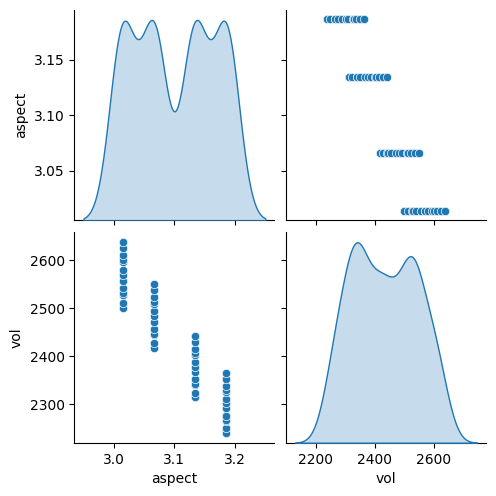

In [4]:
# Input epistemic uncertainties
# plot_list = list(vary.keys())

# pneutpv and palppv are outputs
# plot_list = ["aspect", "fgwped", "pneutpv", "vol"]
plot_list = ["aspect", "vol"]
# plot_list = ["vol"]
sub_df = samples[plot_list]
# pairplot doesn't support MultiIndexed columns
sub_df.columns = sub_df.columns.droplevel(1)
# sns.pairplot(sub_df, kind="scatter", diag_kind="hist")
sns.pairplot(sub_df, kind="scatter", diag_kind="kde")

# Attempting to plot entire results df (39 columns) takes >2 mins


Text(0, 0.5, 'Density')

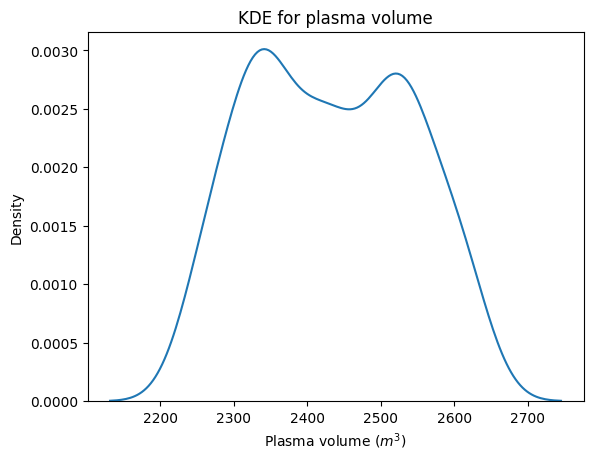

In [5]:
# Input epistemic uncertainties
plot_list = ["vol"]
sub_df = samples[plot_list]
# pairplot doesn't support MultiIndexed columns
sub_df.columns = sub_df.columns.droplevel(1)

# ax = sns.pairplot(sub_df, kind="scatter", diag_kind="kde", ax=ax)

ax = sns.kdeplot(sub_df, legend=False)
# Plot
ax.set_title("KDE for plasma volume")
ax.set_xlabel("Plasma volume ($m^3$)")
ax.set_ylabel("Density")


Text(0, 0.5, 'Density')

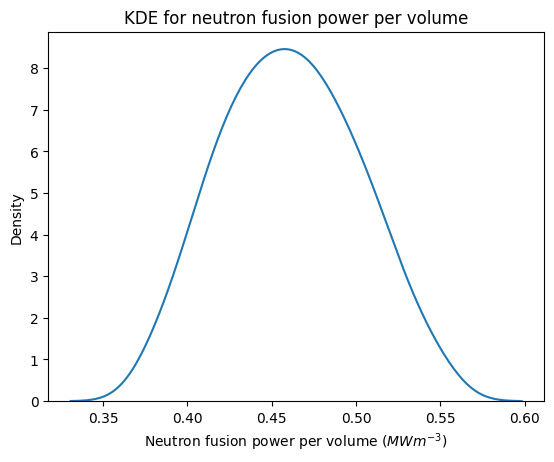

In [6]:
# Input epistemic uncertainties
plot_list = ["pneutpv"]
sub_df = samples[plot_list]
# pairplot doesn't support MultiIndexed columns
sub_df.columns = sub_df.columns.droplevel(1)

# ax = sns.pairplot(sub_df, kind="scatter", diag_kind="kde", ax=ax)

ax = sns.kdeplot(sub_df, legend=False)
# Plot
ax.set_title("KDE for neutron fusion power per volume")
ax.set_xlabel("Neutron fusion power per volume ($MW m^{-3}$)")
ax.set_ylabel("Density")


This will block until all evaluations are complete.

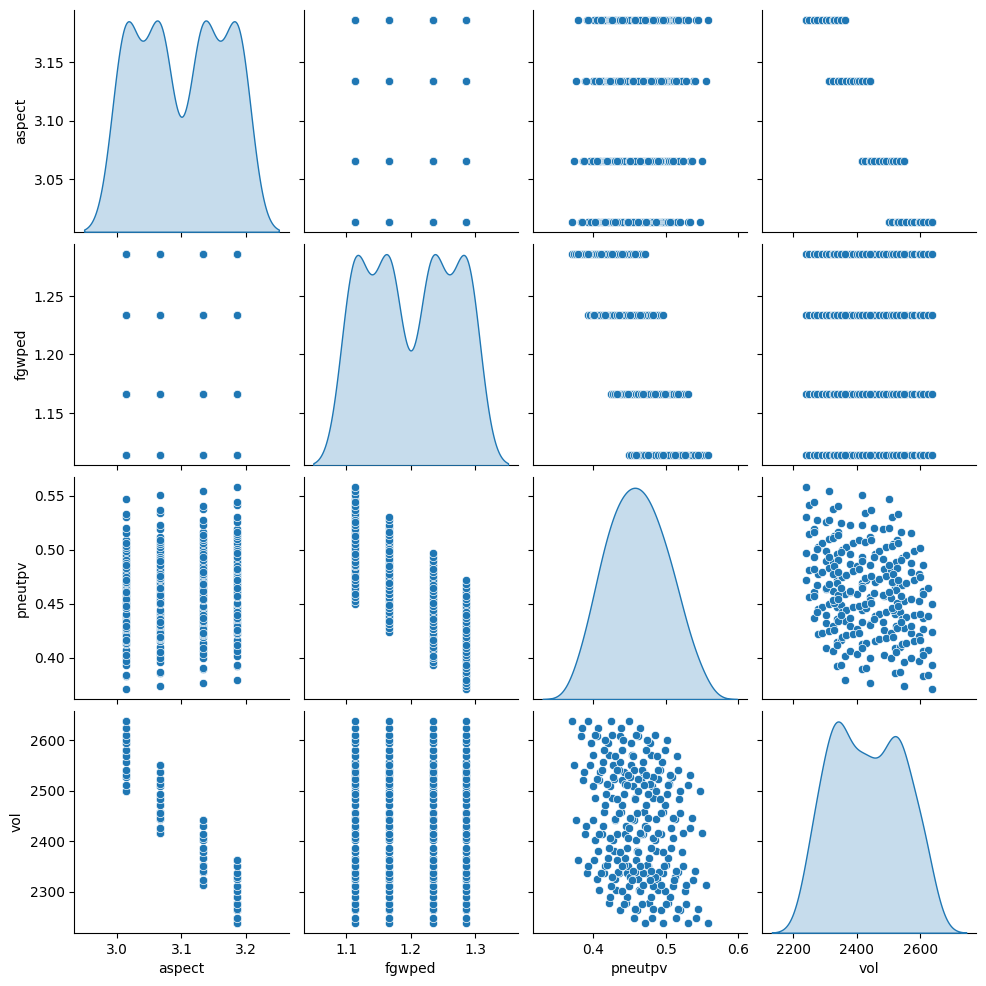

In [7]:
# Input epistemic uncertainties
# plot_list = list(vary.keys())

# pneutpv and palppv are outputs
plot_list = ["aspect", "fgwped", "pneutpv", "vol"]
sub_df = samples[plot_list]
# pairplot doesn't support MultiIndexed columns
sub_df.columns = sub_df.columns.droplevel(1)
# sns.pairplot(sub_df, kind="scatter", diag_kind="hist")
sns.pairplot(sub_df, kind="scatter", diag_kind="kde")

# Attempting to plot entire results df (39 columns) takes >2 mins
